In [1]:
import numpy as np
import skimage as skf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.ndimage import correlate

%matplotlib inline

In [2]:
def video(fname, mimetype):
    from IPython.display import HTML
    video_encoded = open(fname, 'rb').read().encode('base64')
    video_tag = '<video controls alt="test" src="data:video/{0};base64,{1}">'.format(mimetype, video_encoded)
    return HTML(data=video_tag)

In [3]:
def randomPos(fielddims, seed_dims, num_seeds):
    # generate a tuple of (x,y) coordinates randomly selected with replacement from within fielddims
    x = np.random.choice(fielddims[0]-seed_dims[0], num_seeds, replace=True) 
    y = np.random.choice(fielddims[1]-seed_dims[1], num_seeds, replace=True)
    return zip(x,y)

In [4]:
def randomNb(dims, totals, neg_mask = None):
    # return a binary neighborhood with size = dims and summing to one of the values in totals
    
    nb = np.zeros([np.prod(dims),1])
    linear_inds = np.array(range(np.prod(dims)))
    
    if neg_mask is not None:
        linear_inds = linear_inds[neg_mask.ravel()]
    
    if isinstance(totals, int):
        totals = [totals]
    
    total = np.random.choice(totals, 1)    
    active = np.random.choice(linear_inds, total, replace=False)
    nb[active] = 1
    nb = nb.reshape(dims)
    
    return nb.astype('int')

In [799]:
def update(field, nbs, nStates, gos, s):
    # advance the cellular automaton simulation by one frame for a given state
    nextState = (s + 1) % nStates        
    sMask = field == s
    uMask = field == nextState
            
    conved = correlate(uMask.astype('int'), nbs[s],mode='wrap') * sMask    
    ix = np.in1d(conved.ravel(), gos[s]).reshape(conved.shape)
    sMask =  sMask.astype('int') * s
    sMask[ix] = nextState
    return sMask

In [465]:
# set field
fielddims = np.array([200,200])

In [820]:
# set number of states and generate neighborhoods
# todo: allow neighborhoods to be 3 dimensional

nStates = 8
nb_dims = [3,3]
neg_mask = np.ones(nb_dims, dtype='bool')
neg_mask[nb_dims[0] / 2, nb_dims[1] / 2] = 0

nbs = [randomNb(nb_dims, [3], neg_mask = neg_mask) for x in range(nStates)]

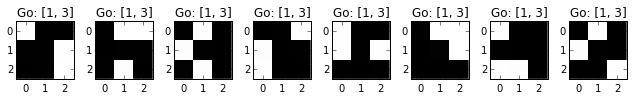

In [845]:
# set up go rules
gos = [[1,3] for state in range(nStates)]
plt_x  = 9
# make sure we have enough subplots
plt_y = (nStates + (plt_x - 1) * (nStates % plt_x)) / plt_x

plt.figure(figsize=(10,10))
for ind, nb in enumerate(nbs):
    plt.subplot(plt_y, plt_x, ind+1)
    plt.imshow(nb, interpolation='None', cmap='gray')
    plt.xticks([0,1,2])
    plt.yticks([0,1,2])
    plt.title('Go: {0}'.format(gos[ind]))
plt.tight_layout()

In [841]:
# set up seeds
seed_dims = [3,60]
seed = np.zeros(seed_dims)
num_seeds = 1000
seedPos = randomPos(fielddims, seed_dims, num_seeds)
field = np.zeros(fielddims)
for pos in seedPos:    
    field[pos[0]:pos[0]+seed_dims[0], pos[1]:pos[1]+seed_dims[1]] = seed + np.random.randint(nStates)

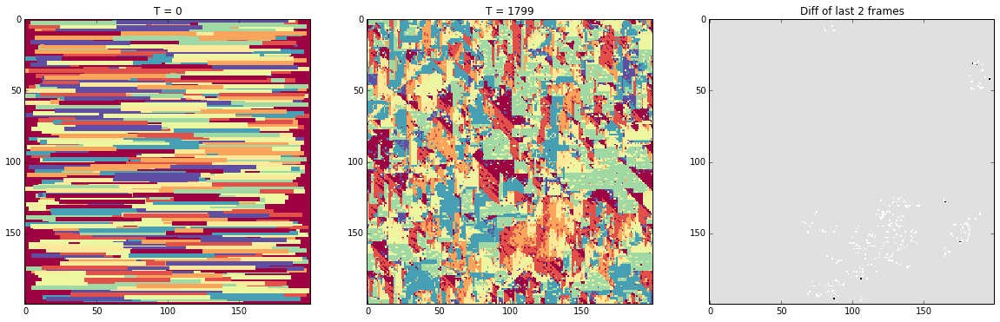

In [854]:
# if extend is True, then the simulation will pick up where it left off
# if extend is False, the simulation will start at field

extend = False
tRange = range(1800)

if extend:
    curField = vol[-1]
else:
    curField = field

vol = np.zeros([len(tRange),fielddims[0],fielddims[1]])
vol[0] = curField
for t in tRange[1:]:
    sMask = curField * 0
    for s in range(nStates):
        sMask += update(curField,nbs,nStates,gos,s)
    curField = sMask
    vol[t] = curField

cmap = 'Spectral'
    
plt.figure(figsize=(20,12))
plt.subplot(131)
plt.imshow(vol[0], cmap=cmap, interpolation='Nearest')
plt.title('T = 0')
plt.subplot(132)    
plt.imshow(vol[-1], cmap=cmap, interpolation='Nearest')    
plt.title('T = {0}'.format(tRange[-1]))
plt.subplot(133)    
plt.imshow(vol[-1] - vol[-2], cmap='gray', interpolation='Nearest')    
plt.title('Diff of last 2 frames')

CPU times: user 40.1 s, sys: 8.76 s, total: 48.8 s
Wall time: 1min 3s


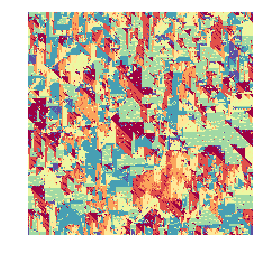

In [855]:
%%time
fig = plt.figure()
fname = 'demo.m4v'
toPlot = vol
tRange = range(toPlot.shape[0])
im = plt.imshow(toPlot[tRange[0]], cmap=cmap, interpolation='Nearest', clim=[0,nStates-1])
plt.axis('off')

def updatefig(t):                
    im.set_array(toPlot[t])    
                                    
ani = animation.FuncAnimation(fig, updatefig, tRange, interval=100
                              , blit=False)
writer = animation.writers['ffmpeg'](fps = 8, codec = 'libx264')
ani.save(fname, writer=writer, dpi = 200)

In [856]:
video(fname, 'x-m4v')

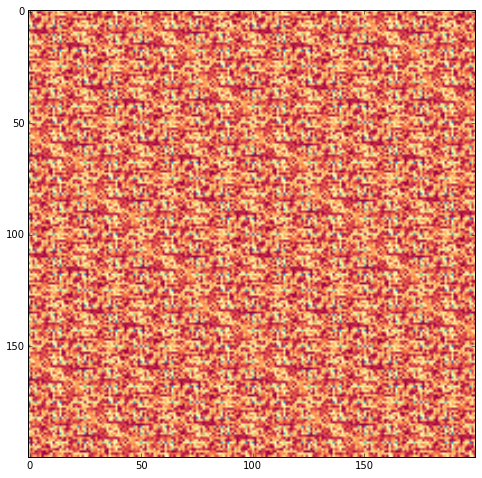

In [450]:
plt.figure(figsize=(8,8))
from numpy import fft
fftvol  = [np.log(np.real(fft.fft2(v))**2) for v in vol]

toPlot = fftvol
plt.imshow(np.log(1+np.real(fft.fft2(vol[400]))**2), cmap='Spectral')

In [ ]:
# test all matplotlib colormaps for a given image
toPlot = vol[-1]
fName = '/Users/bennettd/Dropbox/media/imag/all_mpl_cmaps.png'

cmaps = 'Spectral, summer, coolwarm, Wistia_r, pink_r, Set1, Set2, Set3, brg_r, Dark2, prism, PuOr_r, afmhot_r, terrain_r, PuBuGn_r, RdPu, gist_ncar_r, gist_yarg_r, Dark2_r, YlGnBu, RdYlBu, hot_r, gist_rainbow_r, gist_stern, PuBu_r, cool_r, cool, gray, copper_r, Greens_r, GnBu, gist_ncar, spring_r, gist_rainbow, gist_heat_r, Wistia, OrRd_r, CMRmap, bone, gist_stern_r, RdYlGn, Pastel2_r, spring, terrain, YlOrRd_r, Set2_r, winter_r, PuBu, RdGy_r, spectral, rainbow, flag_r, jet_r, RdPu_r, gist_yarg, BuGn, Paired_r, hsv_r, bwr, cubehelix, Greens, PRGn, gist_heat, spectral_r, Paired, hsv, Oranges_r, prism_r, Pastel2, Pastel1_r, Pastel1, gray_r, jet, Spectral_r, gnuplot2_r, gist_earth, YlGnBu_r, copper, gist_earth_r, Set3_r, OrRd, gnuplot_r, ocean_r, brg, gnuplot2, PuRd_r, bone_r, BuPu, Oranges, RdYlGn_r, PiYG, CMRmap_r, YlGn, binary_r, gist_gray_r, Accent, BuPu_r, gist_gray, flag, bwr_r, RdBu_r, BrBG, Reds, Set1_r, summer_r, GnBu_r, BrBG_r, Reds_r, RdGy, PuRd, Accent_r, Blues, autumn_r, autumn, cubehelix_r, nipy_spectral_r, ocean, PRGn_r, Greys_r, pink, binary, winter, gnuplot, RdYlBu_r, hot, YlOrBr, coolwarm_r, rainbow_r, Purples_r, PiYG_r, YlGn_r, Blues_r, YlOrBr_r, seismic, Purples, seismic_r, RdBu, Greys, BuGn_r, YlOrRd, PuOr, PuBuGn, nipy_spectral, afmhot'
cmaps = cmaps.split(',')
cmaps = [cm.strip() for cm in cmaps]

n_plots = len(cmaps)
n_plots_x = 12
n_plots_y = n_plots / n_lots_x


plt.figure(figsize=(6 * plots_x, 6*plots_y))
for ind, cm in enumerate(cmaps):
    plt.subplot(n_plots_y, n_plots_x, ind+1)
    plt.imshow(toPlot, cmap=cm, interpolation = 'None')
    plt.axis('off')
    plt.title(cm)

plt.tight_layout()
plt.savefig(fName)